# Installs/Imports

In [2]:
%%time

! pip install ultralytics==8.1.29 -qq

CPU times: total: 15.6 ms
Wall time: 1.5 s


In [3]:
import warnings
warnings.filterwarnings("ignore")

import os
import re
import glob
import yaml
import subprocess

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_palette('Set3')

import IPython.display as display
from IPython.display import Video

from PIL import Image
import cv2

import torch

from ultralytics import YOLO


A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.0.2 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "C:\Users\QCWorkshop17\AppData\Local\Programs\Python\Python39\lib\runpy.py", line 197, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "C:\Users\QCWorkshop17\AppData\Local\Programs\Python\Python39\lib\runpy.py", line 87, in _run_code
    exec(code, run_globals)
  File "c:\NYU\SafeSight\venv\lib\site-packages\ipykernel_launcher.py", line 18, in <module>
    app.launch_new_instance()
  File "c:\NYU\SafeSight\venv\lib\site-packages\traitlets\config\application.py", line 1075, in launch_inst

AttributeError: _ARRAY_API not found

In [4]:
import ultralytics
print(ultralytics.__version__)

8.1.29


In [5]:
class CFG:
    ### inference: use any pretrained or custom model
    # WEIGHTS = 'yolov8x.pt' # yolov8n.pt, yolov8s.pt, yolov8m.pt, yolov8l.pt, yolov8x.pt
    #WEIGHTS = 'yolo8s.pt'
    WEIGHTS = ".src/yolov8s.pt"

    CONFIDENCE = 0.60
    CONFIDENCE_INT = int( round(CONFIDENCE * 100, 0) )

    CLASSES_TO_DETECT = [0, 2, 4, 5, 7] # Hardhat, NO-Hardhat, NO-Safety Vest, Person, Safety Vest

    VERTICES_POLYGON = np.array([[200,720], [0,700], [500,620], [990,690], [820,720]])

    EXP_NAME = 'ppe'

    ### just some video examples
    VID_001 = '../dataset/video-example-for-ppe-red-zone/example_video.mp4'

    ### choose filepath to make inference on (image or video)
    PATH_TO_INFER_ON = VID_001
    EXT = PATH_TO_INFER_ON.split('.')[-1] # get file extension
    FILENAME_TO_INFER_ON = PATH_TO_INFER_ON.split('/')[-1].split('.')[0] # get filename

    ### paths
    ROOT_DIR = 'video-example-for-ppe-red-zone/'
    OUTPUT_DIR = './'

# CFG

In [6]:
glob.glob(CFG.ROOT_DIR + '*')

[]

## Image utils

In [7]:
def get_image_properties(image):
    if isinstance(image, str):
        # If image is a file path, read the image
        img = cv2.imread(image)
        if img is None:
            raise ValueError("Could not read image file")
    elif isinstance(image, np.ndarray):
        # If image is already a NumPy array, use it directly
        img = image
    else:
        raise ValueError("Input must be a file path or a NumPy array")

    # Get image properties
    properties = {
        "width": img.shape[1],
        "height": img.shape[0],
        "channels": img.shape[2] if len(img.shape) == 3 else 1,
        "dtype": img.dtype,
    }

    return properties

In [8]:
def display_image(image, print_info = True, hide_axis = False):
    if isinstance(image, str):  # Check if it's a file path
        img = Image.open(image)
        plt.imshow(img)
    elif isinstance(image, np.ndarray):  # Check if it's a NumPy array
        image = image[..., ::-1]  # BGR to RGB
        img = Image.fromarray(image)
        plt.imshow(img);
    else:
        raise ValueError("Unsupported image format")

    if print_info:
        print('Type: ', type(img), '\n')
        print('Shape: ', np.array(img).shape, '\n')

    if hide_axis:
        plt.axis('off')

    plt.show()

## Video utils

In [9]:
def get_video_properties(video_path):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Check if the video file is opened successfully
    if not cap.isOpened():
        raise ValueError("Could not open video file")

    # Get video properties
    properties = {
        "fps": int(cap.get(cv2.CAP_PROP_FPS)),
        "frame_count": int(cap.get(cv2.CAP_PROP_FRAME_COUNT)),
        "duration_seconds": int( cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS) ),
        "width": int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        "height": int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        "codec": int(cap.get(cv2.CAP_PROP_FOURCC)),
    }

    # Release the video capture object
    cap.release()

    return properties

In [10]:
### testing function
video_properties = get_video_properties(CFG.VID_001)
video_properties

{'fps': 29,
 'frame_count': 697,
 'duration_seconds': 24,
 'width': 1280,
 'height': 720,
 'codec': 877677894}

In [60]:

import os
import subprocess

# ✅ Set your input file here
CFG_PATH_TO_INFER_ON = r"../dataset/video-example-for-ppe-red-zone/example_video.mp4"  # <-- change this
OUT_VIDEO_NAME = "./video_to_infer.mp4"

# ✅ Check if input file exists
if not os.path.exists(CFG_PATH_TO_INFER_ON):
    raise FileNotFoundError(f"❌ Input file not found: {CFG_PATH_TO_INFER_ON}")

print(f"✅ Input file found: {CFG_PATH_TO_INFER_ON}")
print(f"➡️ Output will be saved as: {OUT_VIDEO_NAME}")

FFMPEG_PATH = r"C:/ffmpeg-2025-09-08-git-45db6945e9-essentials_build/bin/ffmpeg.exe"  # <-- change to where you extracted ffmpeg

subprocess.run([
    FFMPEG_PATH, "-i", CFG_PATH_TO_INFER_ON,
    "-crf", "23", "-preset", "veryfast",
    "-hide_banner", "-loglevel", "error",
    "-vcodec", "libx264", OUT_VIDEO_NAME
])



✅ Input file found: ../dataset/video-example-for-ppe-red-zone/example_video.mp4
➡️ Output will be saved as: ./video_to_infer.mp4


FileNotFoundError: [WinError 2] The system cannot find the file specified

# 👀📽️ Video to make inference on

# ⚡Adjust Red Zone

- Define ROI (Region of Interest, Red Zone, Danger Zone)
- Manually test and tune the Red Zone for your image or video
- After tuning polygon vertices, don't forget to update it in `CFG` section (VERTICES_POLYGON parameter)
- This will be used in `Annotate` section to post-process images and predictions, counting people in the Red Zone

In [11]:
print('File path to make inference on: ', CFG.PATH_TO_INFER_ON)
print('File name to make inference on: ', CFG.FILENAME_TO_INFER_ON)

File path to make inference on:  ../dataset/video-example-for-ppe-red-zone/example_video.mp4
File name to make inference on:  example_video


In [12]:
cap = cv2.VideoCapture(CFG.PATH_TO_INFER_ON)

if not cap.isOpened():
    print("Error: Could not open video file.")
else:
    # Read the first frame
    ret, frame_test = cap.read()
    cap.release()

vertices_polygon = np.array([[200,720], [0,700], [500,620], [990,690], [820,720]]) # manually adjusted

cv2.polylines(frame_test, [vertices_polygon.reshape(-1, 1, 2)], True, (0, 0, 128), 4)

mod = frame_test.copy()
overlay = cv2.fillPoly(mod, pts = [vertices_polygon], color=(0, 0, 128))
background = frame_test.copy()

frame_test = cv2.addWeighted(
    src1 = background, # fisrt image
    alpha = 0.6, # first image weight
    src2 = overlay, # second image
    beta = 0.4, # second image weight
    gamma = 0.1, # scalar factor
    dst = overlay # output array shape
)

Type:  <class 'PIL.Image.Image'> 

Shape:  (720, 1280, 3) 



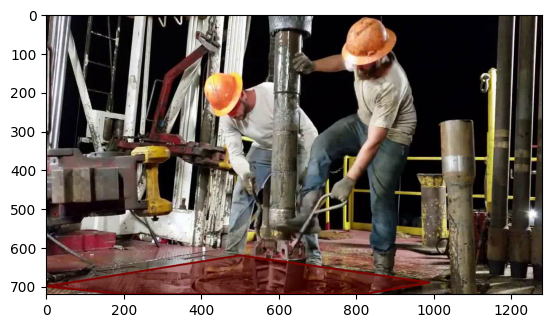

In [13]:
display_image(frame_test)

In [14]:
img_properties = get_image_properties(frame_test)
img_properties

{'width': 1280, 'height': 720, 'channels': 3, 'dtype': dtype('uint8')}

After tuning the polygon vertces, just update them in CFG class.

In [15]:
import os

# Recursively list all files in the 'bestpt' dataset
for root, dirs, files in os.walk("/kaggle/input/bestpt"):
    for name in files:
        print(os.path.join(root, name))


# Model

With Ultralytics API you can easily run inference on any task:
  - Detection
  - Segmentation
  - Classification
  - Pose estimation

You can also make inference with any pre-trained Yolo model or any Custom model you've trained before.

For any of these changes, just change the model name when instantiating the YOLO object.

The post-processing section in this notebook is designed to clean and manipulate the outputs from the object detection task.

In [16]:
import torch
from ultralytics import YOLO
from ultralytics.nn.tasks import DetectionModel
import ultralytics.nn.modules as um
from torch.nn import Sequential


def load_yolo_safe(weights_path):
    # Register all relevant YOLO + torch classes
    safe_classes = [DetectionModel, Sequential]
    for name in dir(um):
        if not name.startswith("__"):
            attr = getattr(um, name)
            if isinstance(attr, type):
                safe_classes.append(attr)
    torch.serialization.add_safe_globals(safe_classes)

    # Monkey-patch torch.load so YOLO can load its weights
    _orig_load = torch.load

    def patched_load(*args, **kwargs):
        kwargs["weights_only"] = False   # force unsafe mode for YOLO weights
        return _orig_load(*args, **kwargs)

    torch.load = patched_load

    try:
        # Let YOLO handle model creation + weight loading internally
        model = YOLO(weights_path)
    finally:
        # Restore original torch.load (safety first)
        torch.load = _orig_load

    return model


# Usage
model = load_yolo_safe(CFG.WEIGHTS)



#model = YOLO(CFG.WEIGHTS)


In [17]:
print('Device: ', model.device)

Device:  cpu


In [18]:
if torch.cuda.is_available():
    model.to('cuda:0')
else:
    print("CUDA device is not available. Running on CPU.")

CUDA device is not available. Running on CPU.


In [19]:
print('Device: ', model.device)
print('Weights: ', CFG.WEIGHTS)

Device:  cpu
Weights:  .src/yolov8s.pt


In [20]:
# model.model
model.names

{0: 'person',
 1: 'bicycle',
 2: 'car',
 3: 'motorcycle',
 4: 'airplane',
 5: 'bus',
 6: 'train',
 7: 'truck',
 8: 'boat',
 9: 'traffic light',
 10: 'fire hydrant',
 11: 'stop sign',
 12: 'parking meter',
 13: 'bench',
 14: 'bird',
 15: 'cat',
 16: 'dog',
 17: 'horse',
 18: 'sheep',
 19: 'cow',
 20: 'elephant',
 21: 'bear',
 22: 'zebra',
 23: 'giraffe',
 24: 'backpack',
 25: 'umbrella',
 26: 'handbag',
 27: 'tie',
 28: 'suitcase',
 29: 'frisbee',
 30: 'skis',
 31: 'snowboard',
 32: 'sports ball',
 33: 'kite',
 34: 'baseball bat',
 35: 'baseball glove',
 36: 'skateboard',
 37: 'surfboard',
 38: 'tennis racket',
 39: 'bottle',
 40: 'wine glass',
 41: 'cup',
 42: 'fork',
 43: 'knife',
 44: 'spoon',
 45: 'bowl',
 46: 'banana',
 47: 'apple',
 48: 'sandwich',
 49: 'orange',
 50: 'broccoli',
 51: 'carrot',
 52: 'hot dog',
 53: 'pizza',
 54: 'donut',
 55: 'cake',
 56: 'chair',
 57: 'couch',
 58: 'potted plant',
 59: 'bed',
 60: 'dining table',
 61: 'toilet',
 62: 'tv',
 63: 'laptop',
 64: 'mou

# ⚡Inference

- We can use multiple GPUs to make inference

In [21]:
"""
import torch

# Save original torch.load
_orig_load = torch.load

def patched_load(*args, **kwargs):
    kwargs["weights_only"] = False
    return _orig_load(*args, **kwargs)

# Patch torch.load temporarily
torch.load = patched_load

try:
    results = model.predict(
        source=CFG.PATH_TO_INFER_ON,
        save=True,
        classes=CFG.CLASSES_TO_DETECT,
        conf=CFG.CONFIDENCE,
        save_txt=True,
        save_conf=True,
        show=True,
        device="cpu",   
        #stream=True,  
    )
finally:
    # Restore original torch.load
    torch.load = _orig_load
"""

import torch
from ultralytics import YOLO
from ultralytics.nn.tasks import DetectionModel
import ultralytics.nn.modules as um
from torch.nn import Sequential

# Collect all relevant classes for safe unpickling
SAFE_GLOBALS = [DetectionModel, Sequential]
for name in dir(um):
    if not name.startswith("__"):
        attr = getattr(um, name)
        if isinstance(attr, type):
            SAFE_GLOBALS.append(attr)

# Patch torch.load temporarily to use safe_globals
_orig_load = torch.load

def patched_load(*args, **kwargs):
    # Ensure weights_only=False so full model is loaded
    kwargs["weights_only"] = False
    return _orig_load(*args, **kwargs)

torch.load = patched_load
torch.serialization.add_safe_globals(SAFE_GLOBALS)

try:
    #Normal YOLO initialization now works
    model = YOLO(CFG.WEIGHTS)
finally:
    # Restore original torch.load
    torch.load = _orig_load

# Use streaming to avoid RAM issues
results = model.predict(
    source=CFG.PATH_TO_INFER_ON,
    save=True,
    save_dir="./runs/detect/my_predict",
    classes=CFG.CLASSES_TO_DETECT,
    conf=CFG.CONFIDENCE,
    save_txt=True,
    save_conf=True,
    show=True,
    device="cpu",
    stream=True
)

for result in results:
    print(result)





video 1/1 (frame 1/697) c:\NYU\SafeSight\src\..\dataset\video-example-for-ppe-red-zone\example_video.mp4: 384x640 2 persons, 514.2ms
ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'ora

In [22]:
#!pip install --upgrade moviepy
import sys
!{sys.executable} -m pip install --upgrade moviepy



# 👀📽️ Raw inference video

- Visualize the inference results from the custom model
- No post-processing done yet

In [23]:
"""
RAW_INFERENCE_VIDEO = glob.glob('/kaggle/working/runs/detect/predict/example_video*')[0] # avi or mp4
OUT_VIDEO_NAME = './raw_inference.mp4'

subprocess.run(
    [
        "ffmpeg",  "-i", RAW_INFERENCE_VIDEO, "-crf",
        "18", "-preset", "veryfast", "-hide_banner", "-loglevel",
        "error", "-vcodec", "libx264", OUT_VIDEO_NAME
    ]
)

Video(data=OUT_VIDEO_NAME, embed=True, height=int(video_properties['height'] * 0.5), width=int(video_properties['width'] * 0.5))
"""


import glob
import os
import subprocess
from IPython.display import Video

# 1️⃣ Find latest YOLO predict folder
predict_folders = sorted(glob.glob('../runs/detect/predict'), key=os.path.getmtime)
if not predict_folders:
    raise FileNotFoundError("No YOLO predict folder found.")

latest_folder = predict_folders[-1]

# 2️⃣ Find any video file in that folder
video_files = glob.glob(os.path.join(latest_folder, "*.mp4")) + \
              glob.glob(os.path.join(latest_folder, "*.avi"))

if not video_files:
    raise FileNotFoundError("No video file found in the latest YOLO predict folder.")

RAW_INFERENCE_VIDEO = video_files[0]
OUT_VIDEO_NAME = './raw_inference.mp4'

ffmpeg_path = r"C:/ffmpeg-2025-09-10-git-c1dc2e2b7c-essentials_build/ffmpeg-2025-09-10-git-c1dc2e2b7c-essentials_build/bin/ffmpeg.exe"  # change to your actual path

subprocess.run([
    ffmpeg_path, "-y", "-i", RAW_INFERENCE_VIDEO,
    "-crf", "18", "-preset", "veryfast",
    "-hide_banner", "-loglevel", "error",
    "-vcodec", "libx264", OUT_VIDEO_NAME
])

# 4️⃣ Display video (adjust height/width as needed)
video_properties = {"height": 720, "width": 1280}  # adjust if you know real dimensions
Video(data=OUT_VIDEO_NAME, embed=True,
      height=int(video_properties['height'] * 0.5),
      width=int(video_properties['width'] * 0.5))




The raw inference looks pretty good.

It is common to get some False Positives in computer vision systems, especially in a case like this where the model that hasn't been trained on the video specific scenario. This can also be mitigated tuning the confidence threshold for the inference (CFG class).

The lower the confidence threshold, the more objects will be detected, and also more False Positives will arise.

So one thing we can do next is to apply some empiric rules to the detections dataframe and try to reduce the number of False Positives. Then, we post-process the video using this new dataframe, annotating the detections.

This isn't always necessary but tuning the confidence threshold and post-processing steps can certainly increase Precision and Recall.

Setting up a good threshold also has high impact in the Red Zone application counting.

In [24]:
raw_inference_video_properties = get_video_properties(RAW_INFERENCE_VIDEO)
raw_inference_video_properties

{'fps': 29,
 'frame_count': 697,
 'duration_seconds': 24,
 'width': 1280,
 'height': 720,
 'codec': 846622071}

# Get predictions

- For Detection task
- Concatenate all txt files (predicted labels) from all images/videos we inferred
- Build a dataframe with predictions from Yolo

In [25]:
def get_predictions_df_for_videos(run = '', model = model, EXP_NAME = CFG.EXP_NAME, video_info = video_properties, save_df = True):
  df = pd.DataFrame()

  root = f'../runs/detect/predict{run}/labels/'
  pieces = sorted([i for i in os.listdir(root)])

  ### iterate over txt files (there is one for each frame in the video)
  for i, frame_txt in enumerate([i for i in pieces]):

    df = pd.read_csv(root + frame_txt, sep=" ", header=None) # read txt file as dataframe
    df.columns = ["class", "x_center", "y_center", "width", "height", "confidence"] # name columns (detection task)

    ### create column 'frame'
    frame_number = re.findall(r'\d+', frame_txt)[-1] # find frame in each txt filename
    df['frame'] = [int(frame_number) for i in range(len(df))]

    if i == 0:
      df_concat = df
    else:
      df_concat = pd.concat([df_concat, df], axis=0).reset_index(drop=True)

  ### create 4 new columns (coordinates converted into pixels): Calculate bounding box coordinates
  df_concat['x_min'] = (df_concat['x_center'] * video_info['width']) - ((df_concat['width'] * video_info['width'])/2)
  df_concat['x_max'] = (df_concat['x_center'] * video_info['width']) + ((df_concat['width'] * video_info['width'])/2)
  df_concat['y_min'] = (df_concat['y_center'] * video_info['height']) - ((df_concat['height'] * video_info['height'])/2)
  df_concat['y_max'] = (df_concat['y_center'] * video_info['height']) + ((df_concat['height'] * video_info['height']/2))

  ### create 2 new columns: height and width in pixels: will be used to filter out bad predictions (false positives)
  df_concat['width_px'] = (df_concat['width'] * video_info['width']).round(0).astype(int)
  df_concat['height_px'] = (df_concat['height'] * video_info['height']).round(0).astype(int)

  ### sort by frame
  df_concat = df_concat.sort_values(by='frame', ascending=True).reset_index(drop=True)

  ### add column 'class_name' and rearrange order
  df_concat['class_name'] = df_concat['class'].map(model.names)
  other_cols = [col for col in df_concat.columns.to_list() if col not in ['frame', 'class_name', 'class', 'confidence' ]]
  new_order = ['frame', 'class_name', 'class', 'confidence'] + other_cols
  df_concat = df_concat[new_order]

  ### export detections df
  if save_df:
    df_concat.to_csv(CFG.OUTPUT_DIR + f'detections_{CFG.EXP_NAME}_c{CFG.CONFIDENCE_INT}.csv', index=False)

  return df_concat

In [26]:
out_df = get_predictions_df_for_videos(
    run = '',
    model = model,
    EXP_NAME = CFG.EXP_NAME,
    video_info = video_properties,
    save_df = False
)

out_df

,frame,class_name,class,confidence,x_center,y_center,width,height,x_min,x_max,y_min,y_max,width_px,height_px
0,1,person,0,0.813888,0.621263,0.500556,0.255003,0.982495,632.01472,958.41856,6.70212,714.09852,326,707
1,1,person,0,0.743652,0.433625,0.565280,0.232629,0.704103,406.15744,703.92256,153.52452,660.47868,298,507
2,2,person,0,0.886647,0.606020,0.502152,0.280903,0.979189,595.92768,955.48352,9.04140,714.05748,360,705
3,2,person,0,0.900586,0.432568,0.567945,0.233054,0.722113,404.53248,702.84160,148.95972,668.88108,298,520
4,3,person,0,0.918189,0.432285,0.569790,0.233700,0.722910,403.75680,702.89280,150.00120,670.49640,299,520
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1188,695,person,0,0.906665,0.498270,0.531920,0.665277,0.915612,212.00832,1063.56288,53.36208,712.60272,852,659
1189,696,person,0,0.935467,0.890936,0.494341,0.218007,0.988681,1000.87360,1279.92256,0.00036,711.85068,279,712
1190,696,person,0,0.901653,0.504702,0.530639,0.675460,0.918123,213.72416,1078.31296,51.53580,712.58436,865,661
1191,697,person,0,0.890107,0.508980,0.528356,0.681295,0.922482,215.46560,1087.52320,48.32280,712.50984,872,664


In [27]:
from pathlib import Path

# Create results directory if it doesn't exist
results_dir = Path.cwd() / "results"
results_dir.mkdir(exist_ok=True)

# Define file paths
csv_path = results_dir / "predictions.csv"
json_path = results_dir / "predictions.json"

# Save as CSV
out_df.to_csv(csv_path, index=False)

# Save as JSON
out_df.to_json(json_path, orient="records", indent=2)

print(f"CSV saved at:   {csv_path}")
print(f"JSON saved at:  {json_path}")


CSV saved at:   c:\NYU\SafeSight\src\results\predictions.csv
JSON saved at:  c:\NYU\SafeSight\src\results\predictions.json


# Post-process predictions

Reduce number of False Positives based on rules that depend on specific characteristics of the images/videos:
  - Environmental factors
  - Context, scenarios
  - Lighting conditions
  - Background
  - Scale, size, distance, viewpoint, perspective

Filter out bad predictions based on the context of the image/video.

In [28]:
def post_process_predictions_df(predictions_df, video_info = video_properties, EXP_NAME = CFG.EXP_NAME, save_df = True):

  df = predictions_df.copy()

  min_person_height = 250
  max_person_width = 620

  img_width = video_properties['width']
  img_height = video_properties['height']

  ### filter out False Positives based on new columns
  df_false_positives1 = df[ (df['height_px'] <= min_person_height) & (df['class_name'] == 'Person') ]
  df_false_positives2 = df[ (df['width_px'] >= max_person_width) & (df['class_name'] == 'Person') ]
  df_false_positives = pd.concat([df_false_positives1, df_false_positives2], axis=0)
  merged = df.merge(df_false_positives, how='left', indicator=True)
  df = merged[merged['_merge'] == 'left_only']
  df = df.drop('_merge', axis=1)
  df = df.reset_index(drop=True)

  print('out_df (raw detections) shape: ', out_df.shape)
  print('df_false_positives1: ', df_false_positives1.shape)
  print('df_false_positives2: ', df_false_positives2.shape)
  print('pp_df (post-processed detections) shape: ', df.shape, '\n')

  ### export detections df
  if save_df:
    df.to_csv(CFG.OUTPUT_DIR + f'detections_{CFG.EXP_NAME}_c{CFG.CONFIDENCE_INT}.csv', index=False)

  return df

In [29]:
pp_df = post_process_predictions_df(
    out_df,
    video_info = video_properties,
    EXP_NAME = CFG.EXP_NAME,
    save_df = False
)

pp_df

out_df (raw detections) shape:  (1193, 14)
df_false_positives1:  (0, 14)
df_false_positives2:  (0, 14)
pp_df (post-processed detections) shape:  (1193, 14) 



,frame,class_name,class,confidence,x_center,y_center,width,height,x_min,x_max,y_min,y_max,width_px,height_px
0,1,person,0,0.813888,0.621263,0.500556,0.255003,0.982495,632.01472,958.41856,6.70212,714.09852,326,707
1,1,person,0,0.743652,0.433625,0.565280,0.232629,0.704103,406.15744,703.92256,153.52452,660.47868,298,507
2,2,person,0,0.886647,0.606020,0.502152,0.280903,0.979189,595.92768,955.48352,9.04140,714.05748,360,705
3,2,person,0,0.900586,0.432568,0.567945,0.233054,0.722113,404.53248,702.84160,148.95972,668.88108,298,520
4,3,person,0,0.918189,0.432285,0.569790,0.233700,0.722910,403.75680,702.89280,150.00120,670.49640,299,520
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1188,695,person,0,0.906665,0.498270,0.531920,0.665277,0.915612,212.00832,1063.56288,53.36208,712.60272,852,659
1189,696,person,0,0.935467,0.890936,0.494341,0.218007,0.988681,1000.87360,1279.92256,0.00036,711.85068,279,712
1190,696,person,0,0.901653,0.504702,0.530639,0.675460,0.918123,213.72416,1078.31296,51.53580,712.58436,865,661
1191,697,person,0,0.890107,0.508980,0.528356,0.681295,0.922482,215.46560,1087.52320,48.32280,712.50984,872,664


I encourage you to take a close look at this dataframe and reflect on how it can be used to post-process predictions and detections in different downstream applications.

# Detections statistics

- These plots can provide valuable information on how confident our model is at predicting each of the classes
- This can be used to tune the confidence threshold on inference videos
- If our custom dataset is similar in train/validation/test/production sets, as it ideally should, we can also tune the confidence threshold using the training plots (Recall-Confidence curve, Precision-Confidence curve, Precision-Recall curve and f1-Confidence curve)

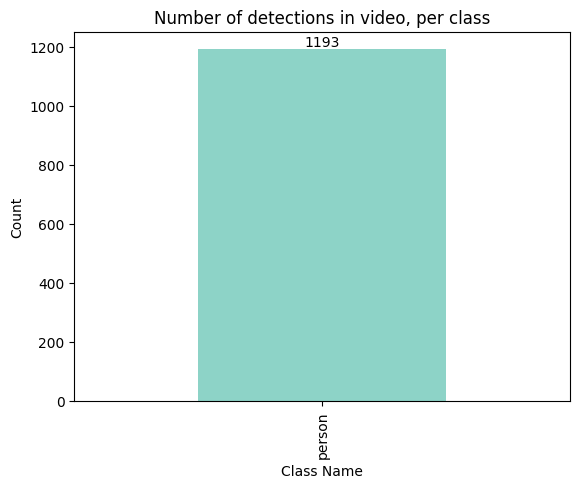

In [30]:
ax = pp_df['class_name'].value_counts().plot(kind='bar')

for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='bottom')

plt.xlabel('Class Name')
plt.ylabel('Count')
plt.title('Number of detections in video, per class')
plt.show()

Looks like the model is indeed detecting the classes that are present in the video.

In [31]:
### median confidence for each class
### this can help tuning the confidence threshold
pp_df.groupby('class_name').confidence.median().round(3).sort_values(ascending=False)

class_name
person    0.897
Name: confidence, dtype: float64

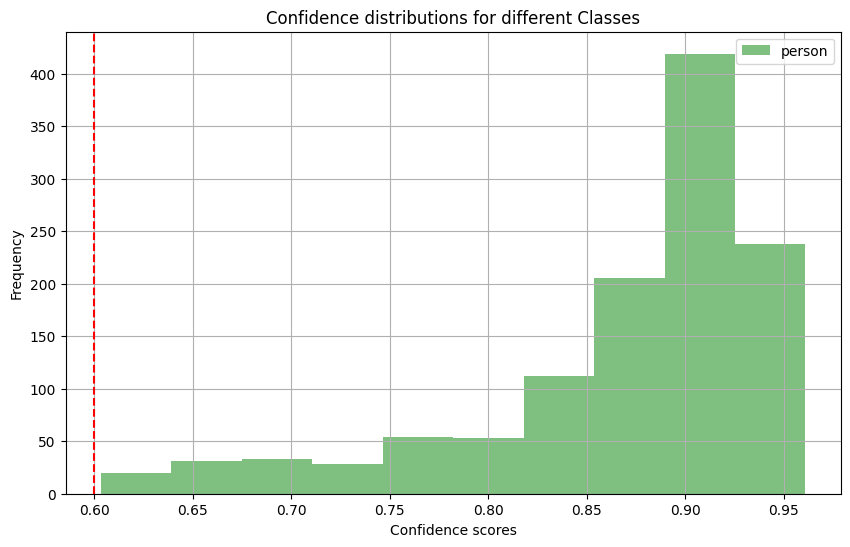

In [32]:
### distribution of confidence scores for each class
grouped = pp_df.groupby('class_name')

colors = ['green', 'red', 'pink', 'blue', 'lime']

plt.figure(figsize=(10, 6))

for i, (group_name, group_data) in enumerate(grouped):
    plt.hist(group_data['confidence'], bins=10, alpha=0.5, label=group_name, color=colors[i])

plt.xlabel('Confidence scores')
plt.ylabel('Frequency')
plt.title('Confidence distributions for different Classes')
plt.axvline(x=CFG.CONFIDENCE, linestyle='dashed', color='red')
plt.legend()
plt.grid(True)
plt.show()

In [33]:
# Export the model
model.export(
    format = 'onnx', # openvino, onnx, engine, tflite
    imgsz = (img_properties['height'], img_properties['width']),
    dynamic=True,
    half = False,
    int8 = False,
    simplify = False,
    nms = False,
)

Ultralytics YOLOv8.1.29 🚀 Python-3.9.13 torch-2.8.0+cpu CPU (Snapdragon X Elite - X1E80100 - Qualcomm Oryon(TM) CPU)
WARNING ⚠️ imgsz=[720, 1280] must be multiple of max stride 32, updating to [736, 1280]

PyTorch: starting from '.src\yolov8s.pt' with input shape (1, 3, 736, 1280) BCHW and output shape(s) (1, 84, 19320) (21.5 MB)

ONNX: starting export with onnx 1.19.0 opset 19...
ONNX: export success ✅ 2.2s, saved as '.src\yolov8s.onnx' (42.6 MB)

Export complete (6.2s)
Results saved to C:\NYU\SafeSight\src\.src
Predict:         yolo predict task=detect model=.src\yolov8s.onnx imgsz=736,1280  
Validate:        yolo val task=detect model=.src\yolov8s.onnx imgsz=736,1280 data=coco.yaml  WARNING ⚠️ non-PyTorch val requires square images, 'imgsz=[736, 1280]' will not work. Use export 'imgsz=1280' if val is required.
Visualize:       https://netron.app


'.src\\yolov8s.onnx'

This shows how much confidence our model has at predicting each of the classes.

This is tighly linked to which classes are present in the video, to the chosen inference threshold and to the degree of (dis)similarity between the images in the training dataset and the images in the video we made inference on.

This is an important information and helps us to adjust our training dataset, improving the quality of the images and labels of the classes that the model hasn't learned well yet.

# ⚡Red Zone

- ROI: Region of Interest, Red Zone, Danger Zone, Risk Area
- For a given frame of the video, count how many people are in and out of the Red Zone
- Polygon is automated with vertices defined in `CFG` class

In [34]:
def count_people_in_red_zone(frame_number, img, detections_dataframe, vertices=CFG.VERTICES_POLYGON):
    '''
    For a given frame (img) of the video, count how many people are in and out of the Red Zone.
    Check position in/out of the Red Zone only for Person class. Don't check other classes.

    Args:
    - frame_number: The frame number to process.
    - img: The frame image.
    - detections_dataframe: DataFrame containing detection information for all frames.
    - vertices: List of vertices defining the Red Zone polygon.

    Returns:
    - total_person_count: Total number of people in the frame.
    - count_person_in_roi: Number of people inside the Red Zone.
    - combined_df: Combined DataFrame with additional columns indicating if each person is in the Red Zone.
    '''

    count_person_in_roi = 0
    count_person_out_roi = 0

    frame_data = detections_dataframe[detections_dataframe['frame'] == frame_number].copy()

    if not frame_data.empty:
        frame_data['is_person_in_roi'] = 0  # Create a new column

        for i, row in frame_data.iterrows():
            if row['class_name'] == 'Person':
                foot_1 = (row['x_min'], row['y_max'])
                foot_2 = (row['x_max'], row['y_max'])

                # Draw little circles on each foot (orange)
                cv2.circle(img, np.array(foot_1).astype(int), 3, (0, 165, 255), -1)
                cv2.circle(img, np.array(foot_2).astype(int), 3, (0, 165, 255), -1)

                # Check if the foot is inside the polygon
                inside1 = cv2.pointPolygonTest(np.array([vertices]), foot_1, False)
                inside2 = cv2.pointPolygonTest(np.array([vertices]), foot_2, False)

                # 1: inside; 0: on border; -1: outside
                if inside1 == 1 or inside2 == 1:
                    count_person_in_roi += 1
                    frame_data.at[i, 'is_person_in_roi'] = 1
                else:
                    count_person_out_roi += 1

        # Calculate the total number of people in the frame
        total_person_count = len(frame_data[frame_data['class_name'] == 'Person'])

        # Create columns in the output DataFrame
        frame_data['person_count_in_roi'] = count_person_in_roi
        frame_data['person_count_out_roi'] = count_person_out_roi

        # Fill missing values with 0
        combined_df = frame_data.fillna(0)

        return total_person_count, count_person_in_roi, combined_df

    else:
        return 0, 0, frame_data

# ⚡Draw

- Draw Bounding Boxes and Red Zone
- Take the output (dataframe) from the red zone function (count_people_in_red_zone) and use it to annotate the predictions on the frame (img)

In [35]:
def draw_bounding_boxes_and_red_zone(df_coords, img, vertices = CFG.VERTICES_POLYGON, thickness=4, show_mask=True):
    '''
    Draw bounding boxes based on coordinates df, and set bbox colors.
    Draw Red Zone based on CFG.

    df_coords: detections dataframe produced by Yolo, already post-processed and then treated in red_zone_pipeline
    img: frame on which the bounding boxes (coordinates in df_coords) will be drawn
    '''

    ### person post-processing
    person_df = df_coords[df_coords['class_name'] == 'Person'].reset_index(drop=True)
    for i, person_detected in person_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(person_detected['x_min']), int(person_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(person_detected['x_max']), int(person_detected['y_min']) )

        if person_detected['is_person_in_roi'] == 1:
            cv2.rectangle(img, start_point, end_point, (0,0,128), thickness) # BGR maroon: in danger
        else:
            cv2.rectangle(img, start_point, end_point, (255,191,0), thickness) # BGR deepskyblue: not in danger

    ### Hardhat post-processing
    hardhat_df = df_coords[df_coords['class_name'] == 'Hardhat'].reset_index(drop=True)
    for i, hardhat_detected in hardhat_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(hardhat_detected['x_min']), int(hardhat_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(hardhat_detected['x_max']), int(hardhat_detected['y_min']) )

        cv2.rectangle(img, start_point, end_point, (0,128,0), thickness) # BGR, green

    ### Safety-Vest post-processing
    safety_vest_df = df_coords[df_coords['class_name'] == 'Safety Vest'].reset_index(drop=True)
    for i, safety_vest_detected in safety_vest_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(safety_vest_detected['x_min']), int(safety_vest_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(safety_vest_detected['x_max']), int(safety_vest_detected['y_min']) )

        cv2.rectangle(img, start_point, end_point, (0,255,0), thickness) # BGR, lime

    ### NO-Hardhat and NO-Safety-Vest post-processing
    no_PPE_df = df_coords[df_coords['class_name'].isin(['NO-Hardhat', 'NO-Safety Vest'])].reset_index(drop=True)
    for i, no_PPE_detected in no_PPE_df.iterrows():

        # top left corner of rectangle
        start_point = ( int(no_PPE_detected['x_min']), int(no_PPE_detected['y_max']) )

        # bottom right corner of rectangle
        end_point = ( int(no_PPE_detected['x_max']), int(no_PPE_detected['y_min']) )

        cv2.rectangle(img, start_point, end_point, (0,255,255), thickness) # BGR, yellow

    ### show mask (Red Zone)
    if show_mask:
        cv2.polylines(img, [vertices.reshape(-1,1,2)], True, (0,0,128), 4) # maroon

        mod = img.copy()
        overlay = cv2.fillPoly(mod, pts = [vertices], color=(0,0,128)) # maroon
        background = img.copy()

        img = cv2.addWeighted(
            src1 = background, # first image
            alpha = 0.6, # first image weight
            src2 = overlay, # second image
            beta = 0.4, # second image weight
            gamma = 0.1, # scalar factor
            dst = overlay # output array shape
        )

    return img

In [36]:
video_properties = get_video_properties(RAW_INFERENCE_VIDEO)
video_properties

{'fps': 29,
 'frame_count': 697,
 'duration_seconds': 24,
 'width': 1280,
 'height': 720,
 'codec': 846622071}

# ⚡Annotate

For each frame in the video:
  - Count people in and out of Red Zone
  - Aggregate count by seconds
  - Draw Bounding Boxes and Red Zone
  - Trigger alert ('Danger')

Then, save the aggregated dataframe with Red Zone People count per second and the post-processed video

In [37]:

%%time
cap = cv2.VideoCapture(CFG.PATH_TO_INFER_ON)

save_exp = True
log = False

fps = cap.get(cv2.CAP_PROP_FPS)
if fps == 0:  # fallback if FPS is not available
    fps = 30  # set a default value

### Parameters to save video
if save_exp:
    ### save path and config for saving
    save_path_video = f'{CFG.OUTPUT_DIR}red_zone_det_vid_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}_pp.mp4'

    out = cv2.VideoWriter(
        save_path_video,
        cv2.VideoWriter_fourcc(*'XVID'),
        video_properties['fps'],
        (video_properties['width'], video_properties['height'])
    )

### create timestamp dataframe from frames dataframe
frame_count = video_properties['frame_count']
fps = video_properties['fps']
print('N frames: ', int(frame_count), '| FPS: ', int(fps))
list_timestamps = [second for second in range(int(frame_count/fps))] # list of timestamps
complete_frame_df = pd.DataFrame() # initialize frame_df

frame_number = 0
outputs_list = []

while cap.isOpened():
    frame_exists, frame = cap.read()

    ### get Timestamp (ts) to create timestamp_df
    ts = int(cap.get(cv2.CAP_PROP_POS_MSEC)) # Current position of the video file in milliseconds
    if log:
        print("Frame: " + str(frame_number) + "timestamp is: ", str(round(ts,2)))

    if not frame_exists:
        print("\nCan't receive frame (stream end?). Exiting...\n")
        break

    ### Count People in Red Zone
    count_person, count_person_roi, frame_df = count_people_in_red_zone(
        frame_number = frame_number,
        img = frame,
        detections_dataframe = pp_df,
        vertices = CFG.VERTICES_POLYGON
    )

    ### store results
    outputs_list.append([ts, frame_number, count_person, count_person_roi])
    complete_frame_df = pd.concat([complete_frame_df, frame_df], axis=0) # update (concat frames)


    ### Aggregate risk detections by seconds to create timestamp_df
    if int(ts/1000) in list_timestamps:
        idx = list_timestamps.index(int(ts/1000))

        ### get the max value of number of people detected on last second
        if idx == 0: # idx = 0 : first frame
            count_person_roi_agg = count_person_roi
        else: # idx > 0
            lower_cut = int(fps * list_timestamps[idx-1])
            upper_cut = int(fps * list_timestamps[idx])
            output_chunk_list = np.array(outputs_list[lower_cut:upper_cut])
            count_person_roi_agg = int(output_chunk_list[:,3].max()) # 3: count_person_roi output


    ### draw bounding boxes and red zone
    frame = draw_bounding_boxes_and_red_zone(
        df_coords = frame_df,
        img = frame,
        vertices = CFG.VERTICES_POLYGON,
        thickness = 4,
        show_mask = True,
    )

    ### print Danger
    h, w, c = frame.shape
    if count_person_roi_agg:
        cv2.putText(
            img = frame,
            text = f'Danger: {count_person_roi_agg}',
            org = ( w - (int(w/3)), h - (h - int(h/6)) ), # bottom-left corner of the text
            fontFace = cv2.FONT_HERSHEY_PLAIN,
            fontScale = 3, # 3,
            color = (0,0,128), # maroon
            thickness = 3
        )
    else:
        cv2.putText(
            img = frame,
            text = f'Danger: {count_person_roi_agg}',
            org = ( w - (int(w/3)), h - (h - int(h/6)) ), # bottom-left corner of the text
            fontFace = cv2.FONT_HERSHEY_PLAIN,
            fontScale = 3, # 3,
            color = (255,191,0), # deepskyblue
            thickness = 3
        )


    ### save frame with detections post-processed
    if save_exp:
        out.write(frame)

    ### Update Frame
    frame_number += 1

cap.release()
if save_exp:
    out.release()
    print('\nVideo saved in: ', save_path_video)
    print('\n\n')
# cv2.destroyAllWindows()

### adjust dtypes and save complete_frame_df
complete_frame_df['is_person_in_roi'] = complete_frame_df['is_person_in_roi'].fillna(0).astype(int)
complete_frame_df['person_count_in_roi'] = complete_frame_df['person_count_in_roi'].fillna(0).astype(int)
complete_frame_df['person_count_out_roi'] = complete_frame_df['person_count_out_roi'].fillna(0).astype(int)
complete_frame_df.to_csv(CFG.OUTPUT_DIR + f'df_frame_PRD_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}.csv', index=False)

### export dataframe with detections per frame
timestamp_df = pd.DataFrame(data = outputs_list, columns=['ts_milliseconds', 'frame_number', 'person_total', 'person_in_roi'])
timestamp_df.to_csv(CFG.OUTPUT_DIR + f'df_ts_PRD_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}.csv', index=False)
timestamp_df
"""

import cv2
import pandas as pd
import numpy as np

# Open video
cap = cv2.VideoCapture(CFG.PATH_TO_INFER_ON)

# Extract video properties
video_properties = {}
video_properties['width'] = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
video_properties['height'] = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
video_properties['frame_count'] = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
video_properties['fps'] = cap.get(cv2.CAP_PROP_FPS)  # ⚡ Important, was missing

print("Video properties:", video_properties)

# Now you can safely use video_properties['fps'], ['width'], ['height'], ['frame_count']
fps = video_properties['fps']
frame_count = video_properties['frame_count']
list_timestamps = [second for second in range(int(frame_count / fps))]

# Video writer setup (if saving)
save_exp = True
if save_exp:
    save_path_video = f'{CFG.OUTPUT_DIR}red_zone_det_vid_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}_pp.mp4'
    out = cv2.VideoWriter(
        save_path_video,
        cv2.VideoWriter_fourcc(*'XVID'),
        fps,
        (video_properties['width'], video_properties['height'])
    )
"""


N frames:  697 | FPS:  29

Can't receive frame (stream end?). Exiting...


Video saved in:  ./red_zone_det_vid_c60_ppe_example_video_pp.mp4



CPU times: total: 10.7 s
Wall time: 9.71 s


'\n\nimport cv2\nimport pandas as pd\nimport numpy as np\n\n# Open video\ncap = cv2.VideoCapture(CFG.PATH_TO_INFER_ON)\n\n# Extract video properties\nvideo_properties = {}\nvideo_properties[\'width\'] = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))\nvideo_properties[\'height\'] = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))\nvideo_properties[\'frame_count\'] = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))\nvideo_properties[\'fps\'] = cap.get(cv2.CAP_PROP_FPS)  # ⚡ Important, was missing\n\nprint("Video properties:", video_properties)\n\n# Now you can safely use video_properties[\'fps\'], [\'width\'], [\'height\'], [\'frame_count\']\nfps = video_properties[\'fps\']\nframe_count = video_properties[\'frame_count\']\nlist_timestamps = [second for second in range(int(frame_count / fps))]\n\n# Video writer setup (if saving)\nsave_exp = True\nif save_exp:\n    save_path_video = f\'{CFG.OUTPUT_DIR}red_zone_det_vid_c{CFG.CONFIDENCE_INT}_{CFG.EXP_NAME}_{CFG.FILENAME_TO_INFER_ON}_pp.mp4\'\n    out = cv2.VideoWriter

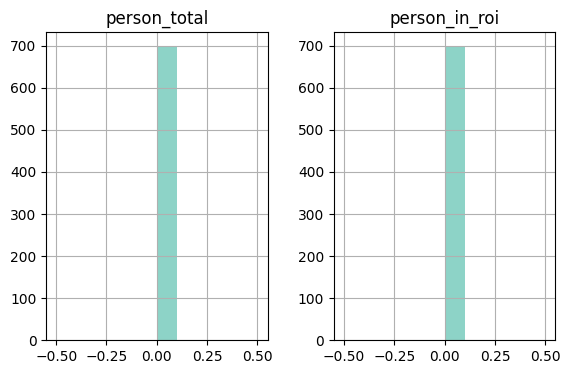

In [38]:
timestamp_df.hist(column = ['person_total', 'person_in_roi'], figsize = (14,4), layout = (1,4));

In [39]:
complete_frame_df

,frame,class_name,class,confidence,x_center,y_center,width,height,x_min,x_max,y_min,y_max,width_px,height_px,is_person_in_roi,person_count_in_roi,person_count_out_roi
0,1,person,0,0.813888,0.621263,0.500556,0.255003,0.982495,632.01472,958.41856,6.70212,714.09852,326,707,0,0,0
1,1,person,0,0.743652,0.433625,0.565280,0.232629,0.704103,406.15744,703.92256,153.52452,660.47868,298,507,0,0,0
2,2,person,0,0.886647,0.606020,0.502152,0.280903,0.979189,595.92768,955.48352,9.04140,714.05748,360,705,0,0,0
3,2,person,0,0.900586,0.432568,0.567945,0.233054,0.722113,404.53248,702.84160,148.95972,668.88108,298,520,0,0,0
4,3,person,0,0.918189,0.432285,0.569790,0.233700,0.722910,403.75680,702.89280,150.00120,670.49640,299,520,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1186,694,person,0,0.899631,0.492467,0.532189,0.657764,0.914607,209.38880,1051.32672,53.91756,712.43460,842,659,0,0,0
1187,695,person,0,0.934151,0.889074,0.494069,0.221319,0.988138,996.37056,1279.65888,0.00000,711.45936,283,711,0,0,0
1188,695,person,0,0.906665,0.498270,0.531920,0.665277,0.915612,212.00832,1063.56288,53.36208,712.60272,852,659,0,0,0
1189,696,person,0,0.935467,0.890936,0.494341,0.218007,0.988681,1000.87360,1279.92256,0.00036,711.85068,279,712,0,0,0


# 👀📽️ Final video

Combining two applications:
- Detect PPE (Person, Hardhat, NO-Hardhat, Safety Vest, NO-Safety Vest)
- Count people in the Red Zone

Classes:
- Person in Red Zone: maroon
- Person not in Red Zone: deepskyblue
- Hardhat: green
- Safety Vest: lime
- No-Safety Vest: yellow
- No-Hardhat: yellow

In [ ]:
OUT_VIDEO_NAME = './pp_inference.mp4'

FFMPEG_PATH = r"C:/ffmpeg-2025-09-10-git-c1dc2e2b7c-essentials_build/ffmpeg-2025-09-10-git-c1dc2e2b7c-essentials_build/bin/ffmpeg.exe"

subprocess.run(
    [
        FFMPEG_PATH, "-i", save_path_video, "-crf",
        "18", "-preset", "veryfast", "-hide_banner", "-loglevel",
        "error", "-vcodec", "libx264", OUT_VIDEO_NAME
    ]
)


Video(data=OUT_VIDEO_NAME, embed=True, height=int(video_properties['height'] * 0.5), width=int(video_properties['width'] * 0.5))

In [ ]:
final_video_properties = get_video_properties(OUT_VIDEO_NAME)
final_video_properties

{'fps': 29,
 'frame_count': 697,
 'duration_seconds': 24,
 'width': 1280,
 'height': 720,
 'codec': 875967080}

# ⚡Video Analytics

- Create a dataframe with detections per seconds
- Plot statistics about the Red Zone and detections

In [ ]:
glob.glob(CFG.OUTPUT_DIR + '/*_ts_*.csv')[0]

'.\\df_ts_PRD_c60_ppe_example_video.csv'

In [ ]:
path_detections_per_milliseconds = glob.glob(CFG.OUTPUT_DIR + '/*_ts_*.csv')[0] # timestamp_df path
df_detections_per_sec = pd.read_csv(path_detections_per_milliseconds)

fps = int(video_properties['fps'])
seconds_agg = 1
rows_agg = fps * seconds_agg

df_detections_per_sec['ts_seconds'] = df_detections_per_sec['ts_milliseconds']/1000 # create column timestamp in seconds

agg_col = [x for x in range(0, len(df_detections_per_sec), fps) for i in range(fps)]

df_detections_per_sec['frame'] = agg_col[:len(df_detections_per_sec)] # create column step size (aggregation)

df_plot = (
    df_detections_per_sec.groupby(['frame'])
    .agg(
        {
            'person_total' : ['mean','max'],
            'ts_seconds' : 'min',
            'person_in_roi' : ['mean','max']
        }
    )
  ).reset_index()

df_plot.columns = ['_'.join(x) for x in df_plot.columns]
df_plot = df_plot.rename(columns = {'frame_' : 'frame'})

new_order = ['ts_seconds_min', 'frame', 'person_total_mean', 'person_total_max', 'person_in_roi_mean', 'person_in_roi_max']
df_plot = df_plot[new_order]
df_plot['ts_seconds_min'] = df_plot['ts_seconds_min'].astype(int)

df_plot = df_plot.round(2)
df_plot

,ts_seconds_min,frame,person_total_mean,person_total_max,person_in_roi_mean,person_in_roi_max
0,0,0,0.0,0,0.0,0
1,1,29,0.0,0,0.0,0
2,2,58,0.0,0,0.0,0
3,3,87,0.0,0,0.0,0
4,4,116,0.0,0,0.0,0
5,5,145,0.0,0,0.0,0
6,6,174,0.0,0,0.0,0
7,7,203,0.0,0,0.0,0
8,8,232,0.0,0,0.0,0
9,9,261,0.0,0,0.0,0


In [ ]:
print('out_df shape: ', out_df.shape) # raw predictions
print('pp_df shape: ', pp_df.shape) # post-processed predictions

print('complete_frame_df shape: ', complete_frame_df.shape) # frame key, class, coordinates
print('timestamp_df shape: ', timestamp_df.shape) # timestamp key, roi_in, roi_out
print('df_plot shape: ', df_plot.shape) # MAV, aggregation to plot

out_df shape:  (1193, 14)
pp_df shape:  (1193, 14)
complete_frame_df shape:  (1191, 17)
timestamp_df shape:  (697, 4)
df_plot shape:  (25, 6)


In [ ]:
def plot_video_analysis(df_plot, title, mav=False, video_properties = final_video_properties):

  cols = ['person_total_mean',  'person_total_max', 'person_in_roi_mean',  'person_in_roi_max']

  fig, ax = plt.subplots(2, 2, figsize = (30, 14))
  line, col = 0, 0

  for var in cols:

    ax_id = ax[line, col]

    if mav:

      df_plot[f'{var}_MAV'] = df_plot[var].rolling(mav).mean().replace(np.nan, 0).round(0).astype(int)

      ax_id.bar(df_plot['ts_seconds_min'], df_plot[f'{var}_MAV'])

      ax_id.axhline(1, color='red', linestyle='--')
      ax_id.axhline(2, color='red', linestyle='--')
      ax_id.axhline(3, color='red', linestyle='--')

    ax_id.set_ylabel('', fontsize=16)

    title_ax = ' '.join(var.split('_'))
    ax_id.set_title(title_ax, fontsize=16, weight=600)
    ax_id.set_xlabel('Time (s)', fontsize=16)
    #ax_id.legend()
    ax_id.set_yticks([0,1,2,3])
    ax_id.set_xlim(0, video_properties['duration_seconds'])

    line = line + 1 if col == 1 else line
    col = col + 1 if col < 1 else 0

  plt.suptitle(title, fontsize=18, y=1.02, fontweight='bold')

  # plt.tight_layout(1.2)

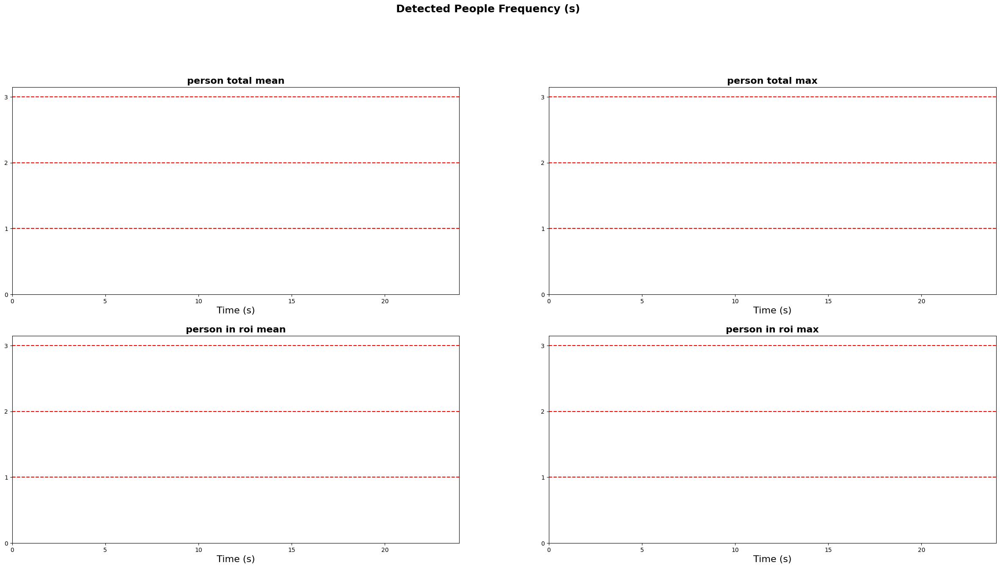

In [ ]:
### mav: moving average: window size of moving average
plot_video_analysis(df_plot, title = 'Detected People Frequency (s)', mav = 2, video_properties = final_video_properties)

# Conclusions

- Despite the domain shift between CSS dataset and the video we made inference on, the YOLO model trained on CSS dataset still was able to perform well, detecting accurately the classes that actually appear in the video: Person, Hardhat, NO-Safety Vest
- You can quickly check this domain shift by yourself if you take a look at the [images in the Roboflow CSS dataset](https://universe.roboflow.com/roboflow-universe-projects/construction-site-safety/browse?queryText=&pageSize=50&startingIndex=0&browseQuery=true), filter by class, and compare it to our 'production video'
- To improve the model, ideally we should collect data (images/videos) from our specific use case and label them, so the model can learn unique characteristics from our setup, environment, scenario, camera angle, perspective, background, lighting conditions etc.
- We should also train the model for much more epochs, since all three loss functions did not show any signs of saturation or overfitting yet (see plots in training notebook)

___

- **We should always aim to build or leverage a custom dataset with diverse images that are representative of the scenarios and situations that the model will face when put into production**
- A more representative and better quality dataset (images and labels) will surely lead to much better accuracy and detections
- Situations where we want to detect a pre-determined set of objects in a fixed camera and controlled environment setup are the most suitable for labeling images and developing a custom dataset. In these cases the model will encounter more predictable conditions in production (matching better what is has seen during training) and will be able to benefit the most from a well prepared data
- There are still tasks and scenarios where a model finetuned on a generic and publicly available dataset can still provide good enough performance
- This video we made inference on is not the best, the camera is too close. But it was the best I could find on Youtube. If you find a better video to try PPE detection on, of course you're welcome to use this model!

___

- **<font color='orange'>If you liked it, don't forget to show your support with your Upvote!</font>**

![image.png](attachment:e47ddf93-3d1b-41e5-8fd9-fcd68b8f17fd.png)